# Used Car Prices CarGurus lightGBM GPU
# Optuna Hyperparameter Optimization

## Set Up Environment, Read Data, Prepare for Modeling

In [ ]:
# In terminal
sudo apt update && sudo apt upgrade

sudo apt-get -y install cmake

sudo apt-get install -y -qq libboost-all-dev libboost-system-dev libboost-filesystem-dev

sudo apt-get install --no-install-recommends nvidia-opencl-dev opencl-headers

sudo apt install glibc-source -y

In [ ]:
%cd /notebooks

In [ ]:
# Clone repo
!git clone --recursive https://github.com/microsoft/LightGBM

Cloning into 'LightGBM'...
remote: Enumerating objects: 28765, done.
remote: Counting objects: 100% (3846/3846), done.
remote: Compressing objects: 100% (451/451), done.
remote: Total 28765 (delta 3575), reused 3485 (delta 3386), pack-reused 24919
Receiving objects: 100% (28765/28765), 20.18 MiB | 2.37 MiB/s, done.
Resolving deltas: 100% (21307/21307), done.
Updating files: 100% (535/535), done.
Submodule 'include/boost/compute' (https://github.com/boostorg/compute) registered for path 'external_libs/compute'
Submodule 'eigen' (https://gitlab.com/libeigen/eigen.git) registered for path 'external_libs/eigen'
Submodule 'external_libs/fast_double_parser' (https://github.com/lemire/fast_double_parser.git) registered for path 'external_libs/fast_double_parser'
Submodule 'external_libs/fmt' (https://github.com/fmtlib/fmt.git) registered for path 'external_libs/fmt'
Cloning into '/notebooks/LightGBM/external_libs/compute'...
remote: Enumerating objects: 21733, done.        
remote: Counting o

In [ ]:
%cd /notebooks/LightGBM

!sudo mkdir build

!sudo mkdir -p /etc/OpenCL/vendors && echo "libnvidia-opencl.so.1" > /etc/OpenCL/vendors/nvidia.icd

/notebooks/LightGBM


In [ ]:
%cd /notebooks/LightGBM/build

/notebooks/LightGBM/build


In [ ]:
# Use cmake to build
!sudo cmake -DUSE_GPU=1 -DOpenCL_LIBRARY=/usr/local/cuda/lib64/libOpenCL.so -DOpenCL_INCLUDE_DIR=/usr/local/cuda/include/ ..

-- OpenCL include directory: /usr/local/cuda/include
-- Using _mm_prefetch
-- Using _mm_malloc
-- Configuring done
-- Generating done
-- Build files have been written to: /notebooks/LightGBM/build


In [ ]:
# Build
!make -j4

[  1%] Built target lightgbm_capi_objs
[ 92%] Built target lightgbm_objs
[ 94%] Built target _lightgbm
[100%] Built target lightgbm


In [ ]:
# Install dependencies
!sudo apt-get -y install python3-pip
!sudo -H pip install setuptools joblib wandb optuna datetime plotly eli5 shap -U

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  python-pip-whl python3-setuptools python3-wheel
Suggested packages:
  python-setuptools-doc
The following NEW packages will be installed:
  python-pip-whl python3-pip python3-setuptools python3-wheel
0 upgraded, 4 newly installed, 0 to remove and 0 not upgraded.
Need to get 2389 kB of archives.
After this operation, 4932 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 python-pip-whl all 20.0.2-5ubuntu1.6 [1805 kB]
Get:2 http://archive.ubuntu.com/ubuntu focal/main amd64 python3-setuptools all 45.2.0-1 [330 kB]
Get:3 http://archive.ubuntu.com/ubuntu focal/universe amd64 python3-wheel all 0.34.2-1 [23.8 kB]
Get:4 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 python3-pip all 20.0.2-5ubuntu1.6 [231 kB]
Fetched 2389 kB in 1s (2944 kB/s)   
Selecting previously unsele

In [ ]:
# Install LightGBM GPU
%cd /notebooks/LightGBM/python-package/
!python setup.py install --gpu --opencl-include-dir=/usr/local/cuda/include/

/notebooks/LightGBM/python-package
INFO:root:running install
/usr/local/lib/python3.9/dist-packages/setuptools/command/install.py:34: SetuptoolsDeprecationWarning: setup.py install is deprecated. Use build and pip and other standards-based tools.
  warnings.warn(
INFO:LightGBM:Starting to compile the library.
INFO:LightGBM:Starting to compile with CMake.
INFO:root:running build
INFO:root:running build_py
INFO:root:running egg_info
INFO:root:writing lightgbm.egg-info/PKG-INFO
INFO:root:writing dependency_links to lightgbm.egg-info/dependency_links.txt
INFO:root:writing requirements to lightgbm.egg-info/requires.txt
INFO:root:writing top-level names to lightgbm.egg-info/top_level.txt
INFO:root:reading manifest file 'lightgbm.egg-info/SOURCES.txt'
INFO:root:reading manifest template 'MANIFEST.in'
INFO:root:adding license file 'LICENSE'
INFO:root:writing manifest file 'lightgbm.egg-info/SOURCES.txt'
INFO:root:copying lightgbm/VERSION.txt -> build/lib/lightgbm
INFO:root:running install_lib


In [ ]:
# Install rapids utils
!pip install cudf-cu11 dask-cudf-cu11 --extra-index-url=https://pypi.ngc.nvidia.com
!pip install cuml-cu11 --extra-index-url=https://pypi.ngc.nvidia.com

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 442.8/442.8 MB 4.7 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.6/76.6 kB 21.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.5/16.5 MB 60.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.8/91.8 MB 16.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 441.3/441.3 kB 58.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 77.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 89.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.3/35.3 MB 40.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.8/8.8 MB 94.7 MB/s eta 0:00:00:00:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.8/8.8 MB 100.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 89.9 M

# Quadro RTX 4000

In [ ]:
# Install/import dependencies
import os
import random
import warnings
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
warnings.filterwarnings('ignore')
my_dpi = 96
print('\n')
!nvcc --version
!nvidia-smi



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Sat Jan 28 13:07:54 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 4000     Off  | 00000000:00:05.0 Off |                  N/A |
| 30%   26C    P8     1W / 125W |      3MiB /  8192MiB |      0%      Default |
|                               |    

In [ ]:
# Set seed 
seed_value = 42
os.environ['UsedCarsCarGurus_lgbmGPU'] = str(seed_value)
random.seed(seed_value)
np.random.seed(seed_value)

In [ ]:
# Set up local CUDA cluster for Dask
cluster = LocalCUDACluster(threads_per_worker=1, ip='', 
                           dashboard_address='8082') 
c = Client(cluster)

# Query the client for all connected workers
workers = c.has_what().keys()
n_workers = len(workers)
c

2023-01-28 13:07:56,875 - distributed.preloading - INFO - Creating preload: dask_cuda.initialize
2023-01-28 13:07:56,875 - distributed.preloading - INFO - Import preload module: dask_cuda.initialize
2023-01-28 13:07:57,249 - distributed.worker - WARNING - Mismatched versions found

+---------+---------------------------------------------+----------------+----------------+
| Package | Worker-a4f6a633-01aa-45b9-b711-4c7e948f65fa | Scheduler      | Workers        |
+---------+---------------------------------------------+----------------+----------------+
| python  | 3.9.16.final.0                              | 3.9.13.final.0 | 3.9.16.final.0 |
| tornado | 6.1                                         | 6.2            | 6.1            |
+---------+---------------------------------------------+----------------+----------------+


Connection method: Cluster object,Cluster type: dask_cuda.LocalCUDACluster
Dashboard: http://10.42.10.98:8082/status,
Dashboard: http://10.42.10.98:8082/status,Workers: 1
Total threads: 1,Total memory: 26.44 GiB
Status: running,Using processes: True
Comm: tcp://10.42.10.98:33121,Workers: 1
Dashboard: http://10.42.10.98:8082/status,Total threads: 1
Started: Just now,Total memory: 26.44 GiB
Comm: tcp://10.42.10.98:39751,Total threads: 1
Dashboard: http://10.42.10.98:35889/status,Memory: 26.44 GiB
Nanny: tcp://10.42.10.98:44325,


In [ ]:
%cd /notebooks/UsedCarsCarGurus/Data/

/notebooks/UsedCarsCarGurus/Data


In [ ]:
# Read data 
trainDF = cudf.read_csv('usedCars_trainSet.csv')
testDF = cudf.read_csv('usedCars_testSet.csv')

# Define label and features
train_label = trainDF[['price']]
test_label = testDF[['price']]

train_features = trainDF.drop(columns = ['price'])
test_features = testDF.drop(columns = ['price'])

# Create dummy variables for categorical variables
train_features = cudf.get_dummies(train_features)
test_features = cudf.get_dummies(test_features)

In [ ]:
# Convert data type for modeling
train_features = train_features.astype('float32')
train_label = train_label.astype('int32')
train_features = train_features.to_numpy()
train_label = train_label.to_numpy()

test_features = test_features.astype('float32')
test_label = test_label.astype('int32')
test_features = test_features.to_numpy()
test_label = test_label.to_numpy()

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_setParams', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_setParams_RTX4000_trainTest_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_GPU_setParams_RTX4000_wb_trainTest_cuml.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 500, 1000, 
                                                step=250),
              'num_leaves': trial.suggest_int('num_leaves', 300, 400, step=25),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10, step=1),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95, 
                                               step=0.05),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81, step=0.02),
              'max_depth': trial.suggest_int('max_depth', 9, 11, step=1),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     500, 600, step=25),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Define model
    model = LGBMRegressor(learning_rate=0.77,
                          lambda_l1=0.02,
                          lambda_l2=0.0015,
                          **params)
    
    # Start timer for each trial
    start = timer()
      
     # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)])
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_GPU_setParams_RTX4000_wb_trainTest_cuml.pkl'):
    study = joblib.load('lightGBM_Optuna_GPU_setParams_RTX4000_wb_trainTest_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=500, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-28 13:12:57.682196


Trial RMSE: 2592.987720197056


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2562.369172025233


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2579.691801397011


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2581.9040515330157


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2563.3975380931


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2578.394020030503


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.77


Trial RMSE: 2566.892664563814


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2590.219144894411


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2595.429538070384


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2588.8353382859777


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2569.6188594157566


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2566.827470578571


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2567.8800247898057


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2576.8214587104817


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2585.1477605778164


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2575.343541620971


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2587.5936814601723


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2562.7170952461347


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2560.2178679983576


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2563.5304724497373


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2558.010586462505


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2553.5272760718417


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2557.9736603672136


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2557.3967954453524


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2563.645386460926


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2557.285758270712


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2572.301917705982


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2558.9467260045462


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2557.6122414923107


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2573.4328859441207


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2569.127453370271


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.7377842447963


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2560.4697110048446


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2562.7485037408974


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2562.2530471778136


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2562.093685934119


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2565.504265883326


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2567.5700820177


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.6481800851


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2588.516394964414


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2558.768567904289


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.9257176672477


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2556.705757895991


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2558.1489335395127


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2547.9269305373255


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2552.5624653194636


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2572.545533135365


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2555.9252764096286


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.8105479197484


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2571.0425866810547


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2556.6388401824697


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2556.8947608759167


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2555.266257108796


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2555.0538177127605


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2556.9095699206573


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2565.3948310330575


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2555.230562783418


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2555.0899494440064


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2561.5930732758607


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2561.81543830782


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2566.9595637870098


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2555.0923759276425


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2557.021741874977


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2558.935261036892


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2556.8692642451306


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2556.878623513078


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2556.69132413753


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2556.9586114600957


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2558.006199396308


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2556.689482465432


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2556.907313673026


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2557.4214218566153


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2557.401245559151


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2557.408626627638


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2557.4322493539876


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2553.367931315707


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2554.902368933423


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2588.1801212415567


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.931428487734


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.9203993029273


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2557.961268878724


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2556.682356507625


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.909442438812


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.934895083197


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.913615545146


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2558.194757660174


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.7882412704585


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2561.3143727736


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2556.6867117653974


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2559.824127040449


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2555.907682035815


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.934342246265


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.9097568390075


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.907905544176


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.910876894776


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2554.9049835708224


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2553.9684962659367


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.77


Trial RMSE: 2555.5084100009794


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.77


Trial RMSE: 2567.8915424183065


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2569.7759791451335


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2558.361793397251


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.77


Trial RMSE: 2550.2394257152664


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2558.844573678982


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2562.3776112342193


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.77


Trial RMSE: 2555.152251729654


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2558.9766019613635


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.77


Trial RMSE: 2564.25423238123


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.940748420441


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2558.928657101775


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2551.1153465284647


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2572.751811208842


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.100563589417


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1006814028437


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.761434143704


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3556789358536


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.530383581389


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9139097618727


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.180703775181


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7441887871732


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.910129819817


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.584735582161


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.379652028849


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1000422147026


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.5296461283046


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.920291903713


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5120645332886


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7485381177607


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9141790755884


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7585224454656


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5153895935573


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7444101199385


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.09828549069


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1006469014333


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.520696760143


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.366574490735


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.19836424107


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5146706223604


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.099477708908


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.2001621110653


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.918582386026


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.093255252119


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.51851589119


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.917305357218


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1908237765497


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.1976633547706


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.760653707197


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.906056763466


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9117237682863


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9111666223966


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1164842208777


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.366126789741


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5075320383316


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5253495071747


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.118125683587


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7442394094005


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7575885996853


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.360670896448


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.37483271833


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1872042804325


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5221826673105


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7492475062327


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.096757774273


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7439219992957


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.518419222669


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0906047671474


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1699060152037


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9029236598585


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.905892216746


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9120357708075


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5165390245033


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0977757707733


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1015441527807


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9161776186224


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.510484802451


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.117658247022


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5101591446232


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5171457526117


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.979413290879


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0950838287854


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7600335779484


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0963726821105


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.519252442967


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5299740470564


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1081727060573


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.764894422742


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.897256643215


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5371709931956


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.516618442604


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0963765991287


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.845445078671


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2551.1003040740984


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.518340162395


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2548.6221588268872


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9144640572545


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1752828271065


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5143955323642


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.093996859217


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.435791353314


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.746966904756


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.096061458744


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0987359921496


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7388140748512


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1084838387474


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5183442268635


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7503922887454


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.913875894498


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7473913780927


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.515413416274


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2571.4303122477104


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.092381586015


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.902080142622


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1071671380073


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.745437661179


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2548.5183420865574


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.509504846927


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.107865523886


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.102920280804


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9100792384634


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.525805095252


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.1723996628766


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7432353060635


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5342633917567


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7691581054223


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.099933491147


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5193482979093


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.515764253056


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9108143146204


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1021220931116


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0955503300816


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.094551094103


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.912283288799


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7432567481305


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1126448018495


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1195728134758


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.110137942497


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7561374169495


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2565.1933332870008


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.100537361815


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2552.6318349637913


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7621907797693


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.361850922791


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.108050713146


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7359334641787


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.760442801374


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.111716753752


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9048906896146


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9160222550827


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.526951194178


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2566.5686725675414


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2578.903881967511


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.203579532436


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2554.512723375793


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.102275911441


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7377517580353


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5288369912664


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9081049091164


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2569.3956409501566


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1105564760473


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7424633802702


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.763795726124


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.362977840638


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.094810034593


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1164541716576


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2565.3187177610957


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.516547816704


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5203516875044


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.8991478238745


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7390219187346


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.909799775458


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.521288216736


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9116461196813


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.523745344302


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.909633587754


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.73966209414


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.36841744427


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7514793806217


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5197883731066


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.0440275946003


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.368828287129


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5282080686047


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.386439008485


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2572.780038431605


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.518292080552


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9024127558196


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.528728893617


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5233926986994


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5180349241473


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0981901634614


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.2980699174686


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2551.090964713097


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.749149733303


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.108690759931


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5140069255694


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5201393994107


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2557.4537781415706


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2551.098276700363


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5112141669692


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3653624807757


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9084464150046


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7612408712553


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.102823625122


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5082014510012


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2548.6134943814704


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3702401015803


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.515225321909


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5262066813484


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.917948619257


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7613430976094


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3798927471203


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.906103879024


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.297435356074


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7584478818458


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2565.061934322545


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.104046891169


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5139685565637


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2581.7294933198273


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2562.0934355580093


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2555.7454490565137


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.744916059177


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3609892953273


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1717477024267


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.518152670272


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.093485322606


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5284746798125


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.188267796896


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.617693522958


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.77


Trial RMSE: 2551.104310766127


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5162004101635


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1068923040225


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.519799509136


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5124571168167


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.3759745408242


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.09704666655


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.911456604789


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.763203230995


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.477023447578


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2566.637936430192


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2576.825800230516


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.107080740208


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7354664890972


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.514003316448


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.477881735818


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3610179633292


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5140990398527


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.105835647759


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5176659184453


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2566.1316103789604


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.653161304387


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.7448324771535


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5302179429077


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.43111013389


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9146390699298


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7696805554224


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.764465927917


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7620948634158


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2564.8803878982976


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2564.760170363679


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2551.0967835169945


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1232135000164


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.897576073116


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2559.389842152742


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.7547031570775


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.909432831016


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.182842758924


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1008578826227


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.262009335453


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2550.3714088287443


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1027618858834


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7630610329384


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7373531791623


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7498833475943


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2557.9494554233656


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.739207629665


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.742903011183


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.519669408532


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5265383597316


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1958861691232


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9014740007915


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2565.244901144432


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1260124082246


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0958762252603


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.097292979048


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.180515373101


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1018169725717


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2573.7104295299196


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.522751740706


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.6475137103466


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.519270393086


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.752150237647


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1065158492265


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9115181883335


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0947929820863


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1023012865453


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5076828077667


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1046586646353


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.065351225618


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.5146731869763


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5257303533867


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9137848270575


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0998376856764


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.09289948277


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2556.5765448645893


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2555.7566348957102


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.198609673667


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1192934359024


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.4168090765243


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5114480442153


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.350631602778


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.377288010631


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2568.933123475538


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1028548133722


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.102576789284


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1935669677


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.916949810477


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9061871141453


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2556.5255107222883


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1017487075173


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1798758928617


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5283399390014


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2569.639257750421


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7394830499165


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.183794260429


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2551.103574645836


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.743501158382


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5052716429054


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3686535416205


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0977369351094


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7452637561328


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5284849125987


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2559.702683045291


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.8986376559537


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.097945995126


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.4517163536516


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2551.0949017918592


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.762770648778


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2553.649999473453


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2550.3817900285976


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5325692677466


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2570.854198895539


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2570.183287004958


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2584.131225724941


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7380522728035


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.0790769553955


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2551.103323142966


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1010877044328


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7544358221094


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.7617842812656


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.528010195791


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2548.5117089100195


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1088469930064


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2568.2471973318634


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.506883111317


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5146858131616


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.887545340081


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.528189952851


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.4943853670293


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.5254858344533


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1147604020885


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.51281318115


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5117535934683


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.548794590768


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1077002071156


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.743723793371


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.098511574745


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.4070430112206


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2550.3750614233395


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7456628293658


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.518726965307


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.7700523372228


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2557.0091462913933


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2551.8921649092626


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.506218594172


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.101745226248


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.101499254181


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0977017139203


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.4756797099512


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.4416624119362


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2551.9056730208226


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.356835789416


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1045818907196


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.719557685381


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1048247730496


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2552.825593942341


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.5191742975608


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2569.3918683826582


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.754867730532


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9088820806683


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.1688691310637


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7443272163705


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.905066426161


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.901405092912


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2567.4482784643756


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2557.0472046663454


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2549.1910553421494


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.756493592804


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.9563271650136


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2551.901861078854


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.350979731338


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7493589674846


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5201691220814


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Start Time           2023-01-28 13:12:57.682196
End Time             2023-01-28 16:12:58.973702
3:00:01


Number of finished trials: 500
Best trial: {'n_estimators': 1000, 'num_leaves': 350, 'bagging_freq': 8, 'subsample': 0.95, 'colsample_bytree': 0.79, 'max_depth': 9, 'min_child_samples': 600}
Lowest RMSE 2547.9269305373255


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_GPU_RTX4000_setParams_wb_trainTest_cuml.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
44          44  2547.926931 2023-01-28 13:29:00.256871   
448        448  2548.511709 2023-01-28 15:56:19.044091   
213        213  2548.518342 2023-01-28 14:32:32.275168   
302        302  2548.613494 2023-01-28 15:05:47.003527   
192        192  2548.622159 2023-01-28 14:25:01.761084   
..         ...          ...                        ...   
39          39  2588.516395 2023-01-28 13:26:40.811503   
9            9  2588.835338 2023-01-28 13:15:47.472349   
7            7  2590.219145 2023-01-28 13:15:11.964632   
0            0  2592.987720 2023-01-28 13:12:57.684010   
8            8  2595.429538 2023-01-28 13:15:29.233377   

             datetime_complete               duration  bagging_freq  \
44  2023-01-28 13:29:17.932547 0 days 00:00:17.675676             8   
448 2023-01-28 15:56:37.078587 0 days 00:00:18.034496             9   
213 2023-01-28 14:32:47.415582 0 days 00:00:15.140414             9   
302 2023-01-28 15:0

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_GPU_setParams_RTX4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_GPU_setParams_RTX4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_GPU_setParams_RTX4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves',
                                                       'max_depth', 
                                                       'subsample',
                                                       'colsample_bytree'])
py.plot(fig, filename='contour_lightGBM_Optuna_GPU_setParams_RTX4000_wb_trainTest_cuml.html')
fig.show()

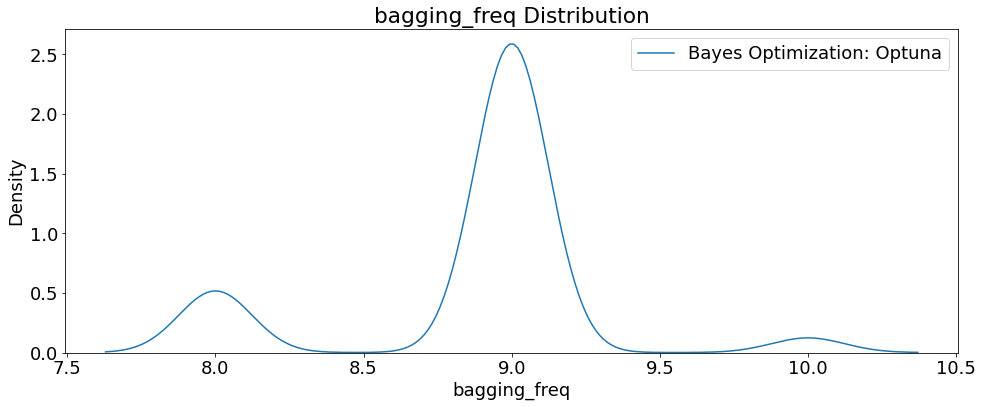

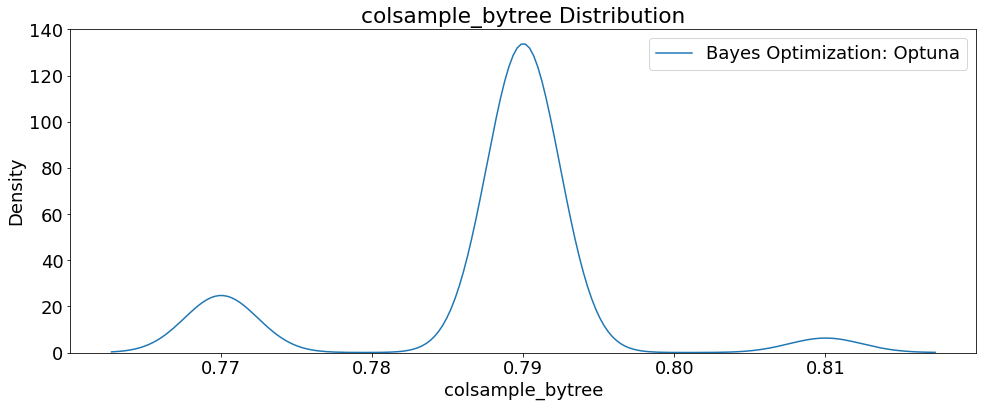

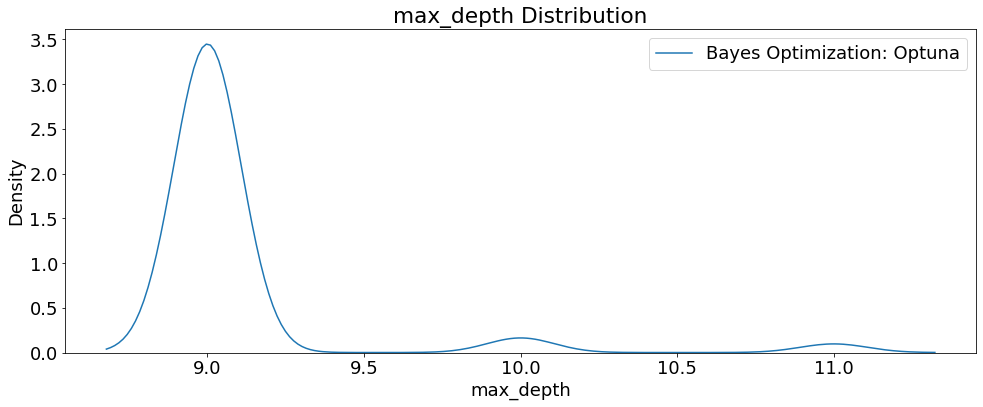

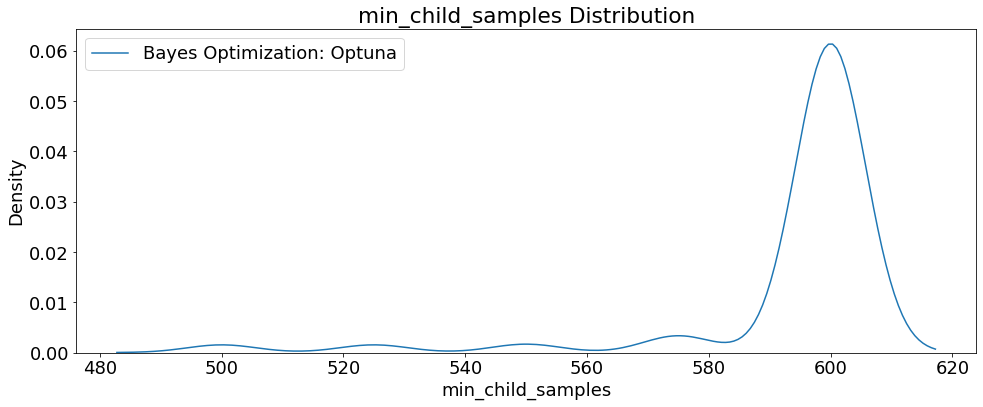

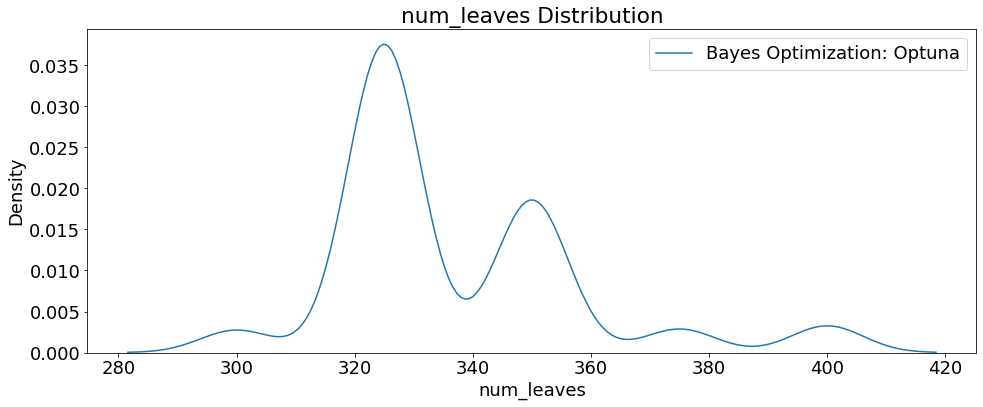

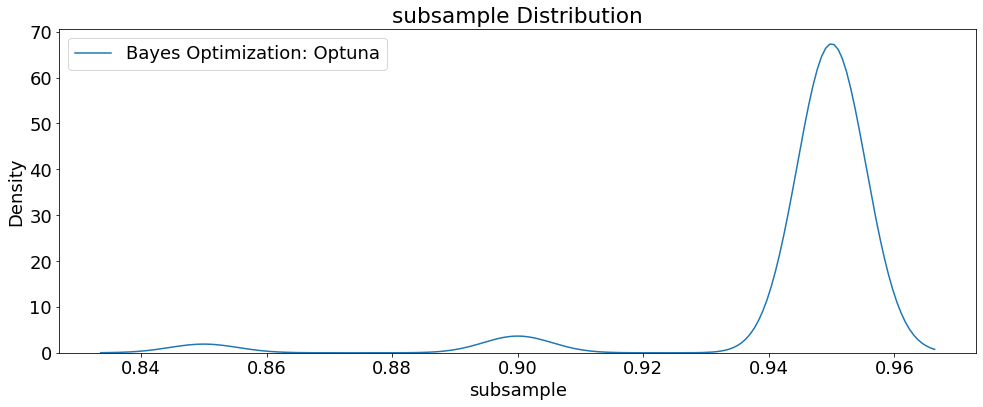

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

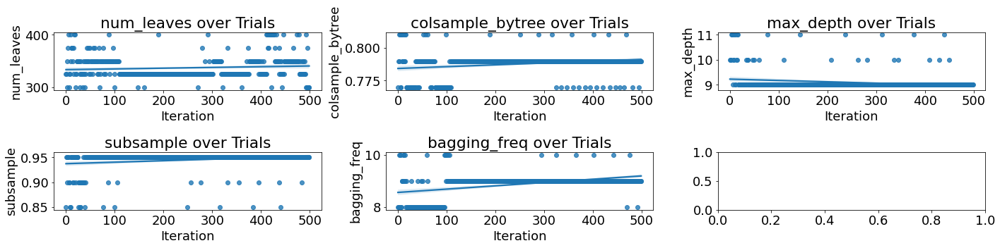

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_GPU_setParams_RTX4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_GPU_setParams_RTX4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 1000,
 'num_leaves': 350,
 'bagging_freq': 8,
 'subsample': 0.95,
 'colsample_bytree': 0.79,
 'max_depth': 9,
 'min_child_samples': 600,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials_GPU_setParams_RTX4000_wb_trainTest_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials_GPU_setParams_RTX4000_wb_trainTest_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for lightGBM HPO GPU Set Parameters trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for lightGBM HPO GPU Set Parameters trials
MAE train: 1717.849, test: 1804.008
MSE train: 5377609.518, test: 5946214.829
RMSE train: 2318.967, test: 2438.486
R^2 train: 0.941, test: 0.935


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5946214.82871 MSE on the test set.
This was achieved using these conditions:
iteration                                    44
rmse                                2547.926931
datetime_start       2023-01-28 13:29:00.256871
datetime_complete    2023-01-28 13:29:17.932547
duration                 0 days 00:00:17.675676
bagging_freq                                  8
colsample_bytree                           0.79
max_depth                                     9
min_child_samples                           600
n_estimators                               1000
num_leaves                                  350
subsample                                  0.95
state                                  COMPLETE
Name: 44, dtype: object


# Quadro RTX 5000

In [ ]:
# Install/import dependencies
import os
import random
import warnings
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
warnings.filterwarnings('ignore')
my_dpi = 96
print('\n')
!nvcc --version
!nvidia-smi



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Sat Jan 28 04:09:10 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 5000     Off  | 00000000:00:05.0 Off |                  Off |
| 33%   33C    P8    13W / 230W |      3MiB / 16384MiB |      0%      Default |
|                               |    

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_setParams', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_setParams_RTX5000_trainTest_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_GPU_setParams_RTX5000_wb_trainTest_cuml.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 500, 1000, 
                                                step=250),
              'num_leaves': trial.suggest_int('num_leaves', 300, 400, step=25),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10, step=1),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95, 
                                               step=0.05),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81, step=0.02),
              'max_depth': trial.suggest_int('max_depth', 9, 11, step=1),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     500, 600, step=25),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Define model
    model = LGBMRegressor(learning_rate=0.77,
                          lambda_l1=0.02,
                          lambda_l2=0.0015,
                          **params)
    
    # Start timer for each trial
    start = timer()
      
     # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)])
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_GPU_setParams_RTX5000_wb_trainTest_cuml.pkl'):
    study = joblib.load('lightGBM_Optuna_GPU_setParams_RTX5000_wb_trainTest_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=500, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-28 04:09:16.342344


Trial RMSE: 2560.670907518311


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2564.1703305834917


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2579.132196581777


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2578.914852608317


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2559.9036598464286


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2590.2751803484834


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2576.3669911242964


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2581.5130583049618


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2594.195567008038


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2570.2735315038203


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2562.120568918419


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2554.501055735434


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2557.8510628714243


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2554.1732134757567


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.515066981596


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5071654166527


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.1486505005373


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7476038682717


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2584.022280303419


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2556.5458388590696


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2551.9069753757904


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.190939052889


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.534192589226


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.1538440586364


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2562.902924226632


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2570.0905087592355


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2555.7821276063682


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2560.956946938933


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2571.261131202411


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.9249324518332


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2558.6362185098615


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2551.094958252039


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5167461307874


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5171660308456


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.530696239203


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2571.5284982614276


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2559.9784977963127


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2595.3152177554643


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2573.4829672428164


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2575.4676022894355


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2565.882190328284


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2551.0999411132343


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1078205627578


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.195048028464


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1016772073426


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2557.418628617718


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2560.3279901394058


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2581.48378958634


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2572.3495832390604


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2555.744533011055


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.6572564335847


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2555.7489120108003


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.106123121246


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.105117013459


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.751799840339


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2566.63443737469


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5162430319547


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.10188376547


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2557.1194433462592


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.509845287916


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7481930081117


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.910544523497


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5173503473184


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.093644318624


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.508065662735


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2562.8978626196185


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.1676160056168


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0968333606484


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.782389550263


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2574.4088154450233


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2562.129951225008


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5370385461006


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7487695309683


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9086852084392


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7441699820297


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9066129545495


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1017740505004


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9028965082675


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2556.7947459150396


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.595071782761


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9130416936255


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5072260691986


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1927284011067


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.512360551159


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0961821291557


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.749186525522


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.105531455838


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9155607536345


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2597.070184189691


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.903374335615


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2566.6380869162444


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.097338041703


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1242917802397


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.909733850474


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.114099046236


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.528035079696


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9058755122037


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.914489382005


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5145649189412


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.7719045542362


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.1364717121965


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1955462993074


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.904557430774


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.179961955953


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.747571343246


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9088768566326


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1760155028915


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3668626024973


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7469311670957


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.521703699074


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0927822171643


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.738438193373


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9136634007023


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.519283251457


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.513517957194


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.108181760644


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1078141843122


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.173611137414


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1169846908324


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.977759935472


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.51322700704


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1957602743737


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.916905554208


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.918354928951


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.518156124434


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.095521765818


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1187462275243


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1062589430617


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.904800583824


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.521532472857


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1020530148276


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.510291351509


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9024009089076


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7613033760636


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.914890109653


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2583.7739914168997


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.524876146288


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1043184092273


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3575884131637


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9168369385907


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7434810306527


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1828175599385


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9107830394537


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.195249559812


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3855247195233


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.103585733572


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9073377073646


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.096266901059


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1106501292934


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1041716399836


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.108444904143


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.535292035805


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.101314291011


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1721550324487


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3522786935314


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.746262152107


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5100798945678


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2565.1337925988228


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.519163649315


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2568.8830901533643


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1171472552537


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.757584474503


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.092132265458


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1009776255983


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1060128413733


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.375790855183


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.919762580346


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.910752459357


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7447486203628


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.516701249294


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2548.6045649372027


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.516321794996


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.516238257234


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.741876097747


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1006178158914


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.912940889564


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5262759569996


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2569.541369122532


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2567.330983371379


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.723693688817


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.112688145313


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1109030388243


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2562.125036856322


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2562.385195991325


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5213069605625


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3673040768094


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7390383249167


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.89971272483


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.901346484094


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.4151308379564


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9038183348284


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.111628211223


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.513391985644


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.521972486626


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.905119523272


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1826005712055


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.907738042116


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.106210925431


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0955583131054


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.7205598432715


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2554.5162440267454


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7488758261534


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5198781415766


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5262515536474


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.376675304617


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9133237844203


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9066913557526


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.754790809536


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1048640042027


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5173080495233


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7550480821596


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3654688615065


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1094736469317


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7446528478417


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1862376899644


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9086895543437


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5239868946096


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9039977085167


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5202806018974


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7363873971344


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5208847891317


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1845537203058


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1022676909574


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7447550882634


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9046133457136


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2587.867990046605


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.095473205842


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.758213619867


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.909770550747


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1098526525


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.515543294841


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.518635117636


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.101437404607


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1858668526497


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2569.03540244679


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.349117383943


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.359482511328


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.747931491674


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5200977403283


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.099737906813


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.921475690982


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7384869496973


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0954687458066


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.18399277711


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5215144394892


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.102841824732


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.219313437511


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2559.064536320125


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2556.2069355730123


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2551.1052709967644


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1799687758817


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.9173468413705


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2556.678736703131


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2550.2157807831736


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2560.8781310079144


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2559.056510209687


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.1404182061647


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.9290301663054


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2550.5238019470494


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.997834119918


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2570.8452006392654


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.7555842649276


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.900663234596


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.8442415464074


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2554.516363234388


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.0554923011723


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2551.677908443801


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2559.389056295553


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2550.181588310016


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2558.005548222156


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2561.494597296833


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2550.899842227072


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2552.832609120356


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2561.4959411177897


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2551.600959946168


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2550.0166232334545


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2558.166983906908


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2560.191609989014


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2561.5021259718797


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2548.9368038591633


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2558.170283589687


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2550.5174918265307


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2561.5013258402832


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2570.835824022063


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2550.5755982573105


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2559.1365529586806


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2559.2985751883384


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2558.289063468127


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2547.893966290371


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2557.723856697147


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2558.940417628334


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2564.583403167362


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2551.031416303817


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2549.0198512653633


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.568827357481


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2560.2727769459107


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.77


Trial RMSE: 2554.9293833161523


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2561.4913647387416


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2551.6068130719777


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2560.50642907668


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2559.837251325559


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.9116495056655


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2561.9318433434837


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2555.7447754806713


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2556.697501403606


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2551.909516409815


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.203850362038


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.4662346921723


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2568.99212095871


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1027144767645


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.916338608258


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.514109810033


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.910468112053


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5081392607412


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.909827003534


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7380904800316


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.911706184208


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9089973533305


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.4757387151803


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3733123437737


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9207130130703


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9034558174917


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1006058672715


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1076630528178


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.116305858674


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5130846529223


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.38562863841


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.299460570811


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2564.6740865182564


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2565.0987832961673


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.520812354483


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5181220323284


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9085676713603


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7519501623615


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.109369038956


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.748758351636


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.518762206408


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.523607636882


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.531922887813


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2553.9179115170027


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2551.1020210862175


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.754483837586


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7511730829933


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.340793161212


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2568.6223525740747


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5133961109204


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9086703844423


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.6258676388516


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2566.669517399848


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.51006096257


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.9709588169967


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.5163874472178


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9020368504453


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2548.300290392867


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.743706618644


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.909901338928


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.122396082287


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.203273503931


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1085648687617


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1092797964725


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.373109342797


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9067818221324


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.748870487955


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.314851382428


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.111254218038


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7651777180495


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2584.6804715699036


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0978460936826


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1085446101397


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.352574496647


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9127616226897


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2568.082434579113


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.095268228935


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.505945112055


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.205504664931


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1994405185733


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.517117730325


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9036987961676


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5297821418926


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.117654462432


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7424492507025


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.193693537059


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7411241320783


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2553.8516060761635


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.512385233682


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.3787100715995


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2549.1970529129535


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5085821496787


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7495598109927


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1105550889965


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.6368907621654


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.2132121275495


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.913757429792


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2557.6448831427415


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2551.0960316265428


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5269892810625


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.105670794486


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.111270340362


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5082338969187


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5082623093203


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9137371958973


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5149278161234


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2565.7133596238905


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.740373912693


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5135157710897


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9128252728506


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5280729225788


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.900227887647


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2577.7634238951678


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.101274899157


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9064467037138


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5063101534834


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0998706764935


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7569275539686


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0960917708912


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.535771588853


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5005497152056


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1163462939303


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5080312180066


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.9110459645135


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2557.416106379206


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2551.1090689693165


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.1675474148005


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.750502303857


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1002783685417


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1048857671744


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3685855618637


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.9689572053667


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.517431880257


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9033828061706


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1092905995492


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2567.445061377561


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.745856315506


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.369073966086


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.098192407266


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1077779807483


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.522778511007


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2585.032684721189


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.741947421298


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.6172024641055


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2550.3705527453303


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.7228455125787


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7422190357415


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.907554861279


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9107903445297


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.674095397852


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2568.824815687245


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.190213512385


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.547113583753


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7519564908043


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.111571699298


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2552.421160113046


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.7493728695513


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.7857072762804


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2551.0997021711796


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2571.3989111006717


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1794926272573


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.948769420713


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.6707287929253


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2549.1919436847056


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.517694613004


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2564.5755567310403


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.746863442003


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1065437309762


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5220806899033


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5073598276854


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2547.837951663505


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2550.2394813835513


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2553.320913088067


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.1520423928287


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2560.675941973304


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2561.50715891965


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.3466343464497


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2553.4238528089522


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2559.399927787232


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2561.4915554115973


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2562.3804770889637


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2568.8483716791243


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2560.336599586824


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2549.1826277875766


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5226218724747


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1752830820674


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1013421349107


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.523752815655


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.1884380853294


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.0596273910955


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2551.0954159973157


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.615647723484


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2555.7447882333254


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2552.1681579019146


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2566.636551156408


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.6496535294273


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5246588290424


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.511110682069


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2553.3505060871


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2551.096986828541


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.535331358202


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5162804604147


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.517644539807


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.508965088691


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Start Time           2023-01-28 04:09:16.342344
End Time             2023-01-28 07:00:01.391838
2:50:45


Number of finished trials: 500
Best trial: {'n_estimators': 750, 'num_leaves': 325, 'bagging_freq': 9, 'subsample': 0.95, 'colsample_bytree': 0.77, 'max_depth': 9, 'min_child_samples': 600}
Lowest RMSE 2547.837951663505


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_GPU_RTX5000_setParams_wb_trainTest_cuml.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
466        466  2547.837952 2023-01-28 06:48:17.404182   
288        288  2547.893966 2023-01-28 05:44:31.966188   
353        353  2548.300290 2023-01-28 06:07:08.859636   
170        170  2548.604565 2023-01-28 05:03:35.398562   
279        279  2548.936804 2023-01-28 05:40:50.361278   
..         ...          ...                        ...   
225        225  2587.867990 2023-01-28 05:21:16.060168   
5            5  2590.275180 2023-01-28 04:10:36.048040   
8            8  2594.195567 2023-01-28 04:11:27.660531   
37          37  2595.315218 2023-01-28 04:19:58.984331   
88          88  2597.070184 2023-01-28 04:37:05.283551   

             datetime_complete               duration  bagging_freq  \
466 2023-01-28 06:48:31.528273 0 days 00:00:14.124091             9   
288 2023-01-28 05:44:54.585329 0 days 00:00:22.619141             9   
353 2023-01-28 06:07:27.259516 0 days 00:00:18.399880             9   
170 2023-01-28 05:0

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_GPU_setParams_RTX5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_GPU_setParams_RTX5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_GPU_setParams_RTX5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample',  
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_GPU_setParams_RTX5000_wb_trainTest_cuml.html')
fig.show()

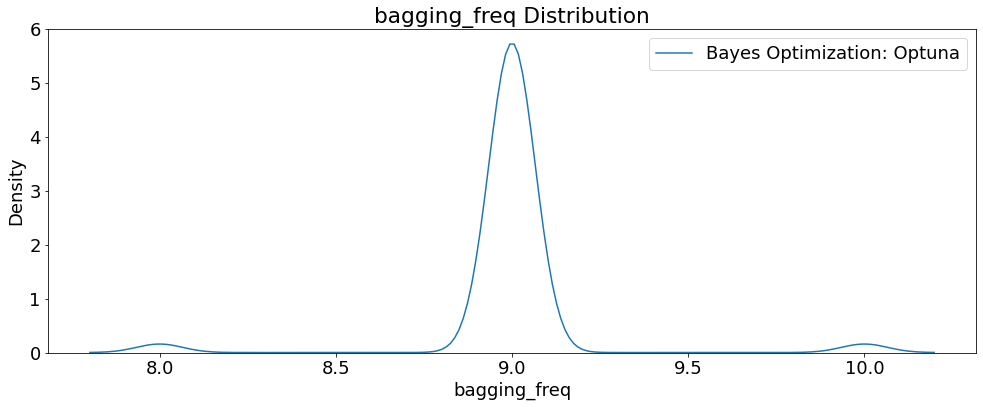

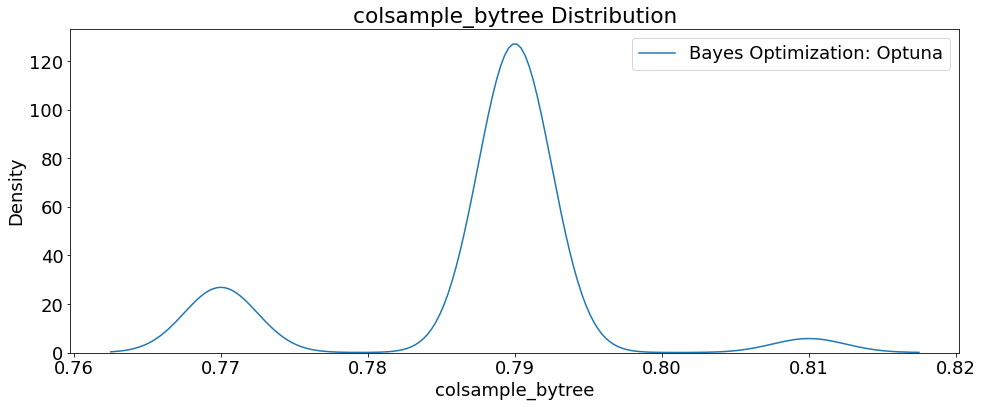

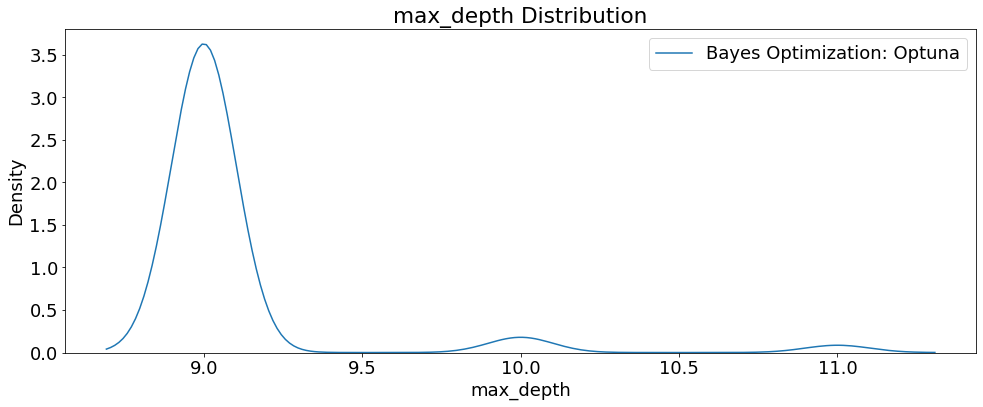

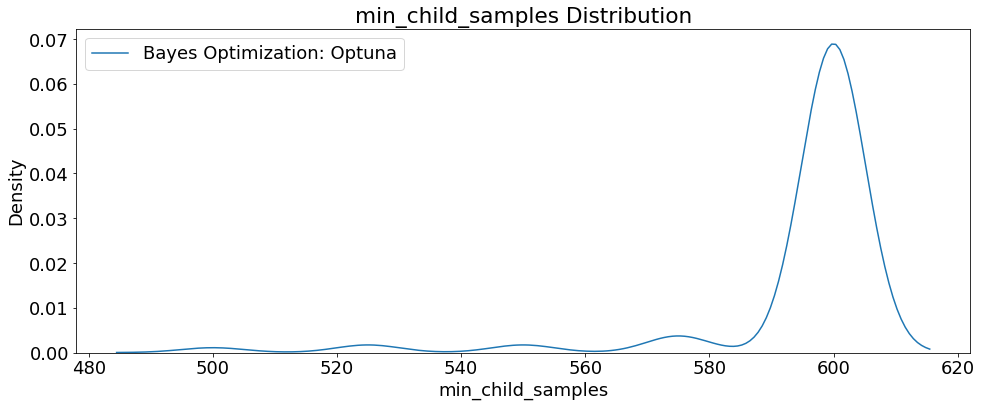

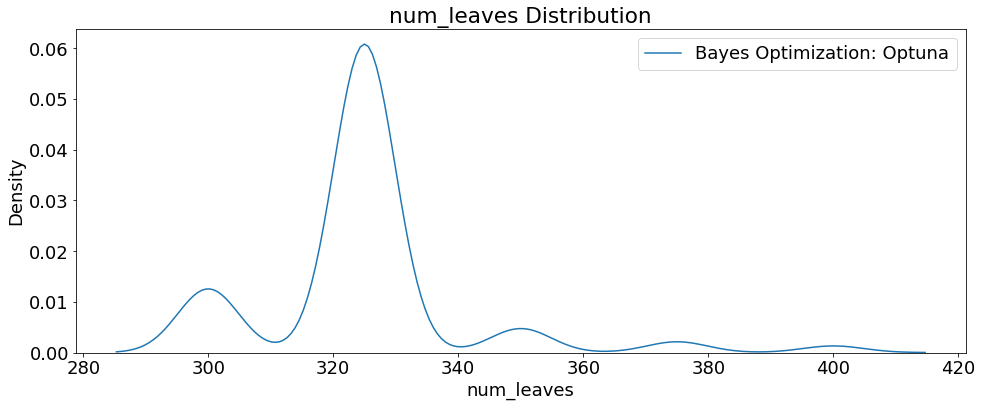

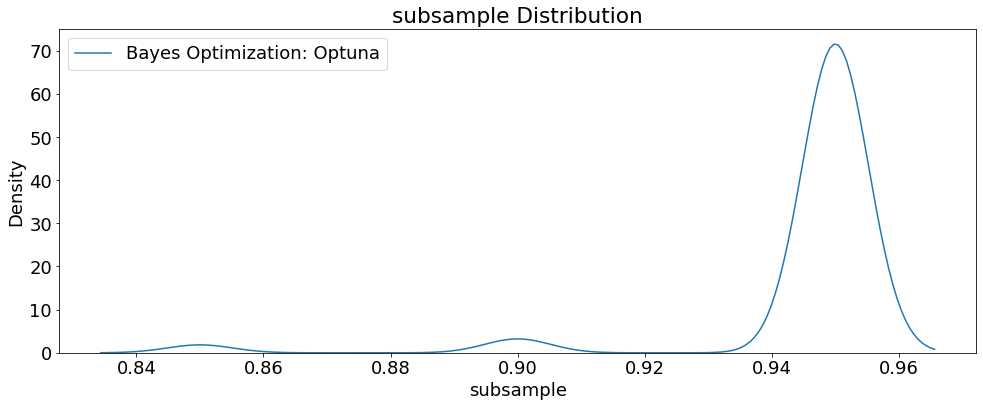

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

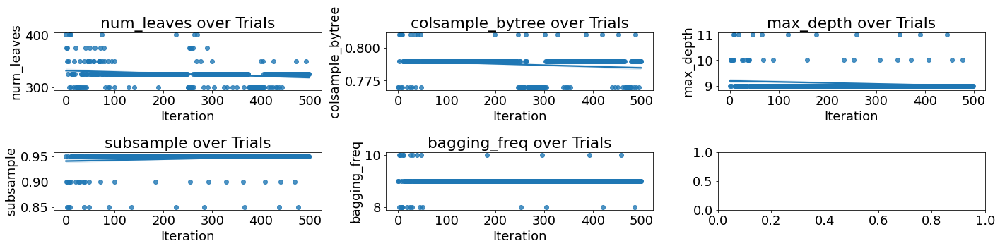

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_GPU_setParams_RTX5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_GPU_setParams_RTX5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 750,
 'num_leaves': 325,
 'bagging_freq': 9,
 'subsample': 0.95,
 'colsample_bytree': 0.77,
 'max_depth': 9,
 'min_child_samples': 600,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials_GPU_setParams_RTX5000_wb_trainTest_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials_GPU_setParams_RTX5000_wb_trainTest_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for lightGBM HPO GPU Set Parameters trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for lightGBM HPO GPU Set Parameters trials
MAE train: 1762.291, test: 1824.720
MSE train: 5648756.619, test: 6065763.097
RMSE train: 2376.711, test: 2462.877
R^2 train: 0.938, test: 0.934


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6065763.09651 MSE on the test set.
This was achieved using these conditions:
iteration                                   466
rmse                                2547.837952
datetime_start       2023-01-28 06:48:17.404182
datetime_complete    2023-01-28 06:48:31.528273
duration                 0 days 00:00:14.124091
bagging_freq                                  9
colsample_bytree                           0.77
max_depth                                     9
min_child_samples                           600
n_estimators                                750
num_leaves                                  325
subsample                                  0.95
state                                  COMPLETE
Name: 466, dtype: object


# RTX A4000

In [ ]:
# Install/import dependencies
import os
import random
import numpy as np  
import warnings
import pandas as pd
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
optuna.logging.set_verbosity(optuna.logging.WARNING) 
from datetime import datetime, timedelta
from timeit import default_timer as timer
import pickle
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
warnings.filterwarnings('ignore')
my_dpi = 96
print('\n')
!nvcc --version
!nvidia-smi
os.environ['CUDA_VISIBLE_DEVICES'] = '0'



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Thu Jan 19 20:00:43 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA RTX A4000    Off  | 00000000:00:05.0 Off |                  Off |
| 41%   38C    P8    14W / 140W |      2MiB / 16376MiB |      0%      Default |
|                               |    

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_setParams', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_setParams_A4000_trainTest_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_GPU_setParams_A4000_wb_trainTest_cuml.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 500, 1000, 
                                                step=250),
              'num_leaves': trial.suggest_int('num_leaves', 300, 400, step=25),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10, step=1),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95, 
                                               step=0.05),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81, step=0.02),
              'max_depth': trial.suggest_int('max_depth', 9, 11, step=1),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     500, 600, step=25),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Define model
    model = LGBMRegressor(learning_rate=0.77,
                          lambda_l1=0.02,
                          lambda_l2=0.0015,
                          **params)
    
    # Start timer for each trial
    start = timer()
      
     # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)])
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_GPU_setParams_A4000_wb_trainTest_cuml.pkl'):
    study = joblib.load('lightGBM_Optuna_GPU_setParams_A4000_wb_trainTest_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=500, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-28 07:55:31.917899


Trial RMSE: 2579.30093429623


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2554.923574115299


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2557.868214504028


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2577.8123764587995


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2580.3413526748727


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2593.110643746136


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2571.4935622688376


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2588.8099411053913


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2566.390695774221


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2559.6573057263927


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2560.1010397472915


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2558.917687824265


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.911464049323


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2557.777674266904


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2557.956033663577


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2562.2284281892908


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2562.014609386081


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2573.1795078517584


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2573.3551425396445


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2557.31886823131


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2561.7644700476244


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2559.247145342571


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2568.557950198895


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2561.677828537464


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2550.5437882327


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2557.7378065256553


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2559.822171182104


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2560.217281278396


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2554.523717011869


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2575.4329584509856


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2549.1803355844713


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.353235825965


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.908370022501


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1073077260435


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.717576107661


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.527165087699


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.944151471782


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2569.0496590612506


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2576.1036109669426


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2550.379259256263


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.7999207589087


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2555.7539192848385


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.102910589642


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.519390475655


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.7312274144306


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2554.5230101535135


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.913532039591


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2576.2139571374873


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2558.5779493727955


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2573.8215686735534


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.372450455177


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9021656428354


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3626815738016


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5113106118006


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7596775812312


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3525151878207


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2565.1152784503624


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.856157575814


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2556.375814179627


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2568.9408273180456


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2582.9688280216255


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.895785293616


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7636819630807


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.100871517157


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.742655338657


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0988623152343


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2566.104469079736


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.985713432891


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.523839373869


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2573.995053462668


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2553.596752402658


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2564.7521858205328


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2554.5177705764418


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.351885740093


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1988302711984


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.106938962887


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0989611176524


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.177685210641


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.173459728833


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.365007533172


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2577.3079015797334


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1025124924668


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.52223819454


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1013598247564


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5267018070517


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.522695959592


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.091245444691


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.348401303205


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.528127711989


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2569.63849405916


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2559.4209433413785


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9121991538605


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.528614621366


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.914821347829


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7586303567546


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7593775580617


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9108797587282


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0989415800764


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2574.2422756773462


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2552.6503740282187


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2564.2041598747533


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3733097451754


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1306397497974


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0932498825728


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.911125896231


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.105963711584


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.176113395775


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1050172169375


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2564.6325504026877


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2568.8216314973756


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.6224739059835


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3545712308246


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.8997395098027


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1124085696824


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1034434074113


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.747757182918


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.524891663217


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1084972540107


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.746876909042


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9059821566448


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.902760635118


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.749547409056


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5150164316046


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.512654756374


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1027068538606


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9179590258063


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5260420051086


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7587405139357


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1914341774773


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9183385623182


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1143362566786


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1131960801736


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.520353309877


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2548.600312482888


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.190617940856


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.517937730021


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9160960724535


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.746516527032


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.170657614152


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3652979494464


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2552.174998543876


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.8990276426666


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.535409248337


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2571.535023575457


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.109023655643


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1045586659475


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9055518284295


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7404911376616


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0959036818804


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2548.518496817668


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.106464921944


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1083333739484


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.2089281295966


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5134916811526


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.188036088662


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1114817926764


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5069278776095


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.507506096309


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.73967511411


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.516095926864


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7423535215507


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5069494709874


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9195170192343


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5200421822447


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.103738520198


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7609201204823


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2573.039343370163


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2582.1063364417823


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.892966823854


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3721690253183


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9105352773


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.100322322784


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3572113989476


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.90544127002


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.74126720342


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5081284107923


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5185410248027


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1960301821296


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.4730572770172


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.2001476771543


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2552.6337601895366


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.897310416781


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9066083624643


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9140134493914


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9055310532653


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7474945505737


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5307139161177


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9149239094327


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5109191588836


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.742983156992


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1196608019463


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1038353129916


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.741134384711


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.914655289707


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.53391459133


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.744195776876


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.08912085178


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.750429161636


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7459808473623


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5255730735976


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9119862185826


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.75715265515


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.111369804481


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.170237006042


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2564.0429496001902


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3540090764586


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.17719451909


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9029896680663


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.10306583747


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5256994585097


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0960058179326


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.518709663839


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9065290087983


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3714421983545


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7423933859654


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.759431559321


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.740268403125


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.759317056259


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.8739392723614


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1248938304097


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.531379170685


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.101371080653


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.113345270384


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7610915729592


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7460109451736


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1055423349367


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.903651110865


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2552.6293234843406


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0926882126587


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0927545324507


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7471197061286


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.749392962829


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5211643295065


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2569.359667305094


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9125401891365


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.095363640889


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.101186109306


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9021799834677


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.6360592300266


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.105486879363


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.373320572108


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.520179870822


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.513369952128


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5123919534344


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1801086064124


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.0761952443786


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2554.511280547966


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7644950203376


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1031716170855


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5129663304697


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5202066579277


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2553.7856714522136


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2555.758630803828


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5268851701762


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0963283800324


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.100199988528


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.358648064753


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.477015144103


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2554.5295634782033


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.747697440584


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.51598572702


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2583.3504642382977


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7656852372625


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1140168144393


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3639082003856


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.120320761377


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.909009490256


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1236309522033


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1038271951456


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.096764445617


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.912107879947


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2570.9345436572585


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.175152015873


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1064373883123


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2563.4873428767955


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3686192929636


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.913202952472


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5337851872137


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2569.628280625426


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5289593969987


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.521665264276


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9064009849076


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.517012054555


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2553.130843993393


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.352561708796


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.373387527728


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7454408978074


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2570.0498252110087


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7605824126


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.521771353757


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.754567977271


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.91405627494


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7502949152595


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2556.1076726046845


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.76270748172


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9112675032143


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7434079073646


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3773199775624


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1056201330225


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5172152531018


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.53119851313


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2561.901235824287


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.1706687886776


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9129460102167


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.103821653421


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9047335602313


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2582.9228128612053


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.5205772691884


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.2065049225225


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2565.4515275843646


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.846827429036


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2555.7342484897786


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.532003599491


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3646330701245


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.516531163132


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.186512412358


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.749398681393


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0906364759685


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.53830855435


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3691457338555


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.099316758576


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5146216583853


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.171629172611


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.0918821742302


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7411507927304


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2557.425266327182


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2562.8047176585746


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2554.526557096059


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.741788508227


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1022820846074


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.367092586812


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.116313329837


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3789385859377


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1025833585327


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.116112267641


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.904374468073


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5093002222743


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1191448035156


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.371157055787


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1015841618414


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7498338120076


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2566.630186386366


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.912802722676


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.092665052535


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7416861833467


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2569.385268174199


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.099400688665


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.102558931862


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.169507926096


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.367612190658


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9205815459286


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1027447892925


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.918093582329


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.349674371934


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.743224291657


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2564.3351212086295


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2559.6809886312044


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1067938041774


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.100086552253


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.088589155565


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7601950071494


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.113030289463


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.376192380696


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.109861650823


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3710426550665


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0987591530456


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.520195839551


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1058413552164


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.6428754004496


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5210426810236


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2564.0679276105598


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2568.8467232927587


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2548.635723530281


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.741867142653


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9014918249713


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1130643080805


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.533488876468


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3605017736754


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.906639248912


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9134591978072


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3688793624106


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2581.7311954649417


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.106531865627


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.109422991552


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9110256720137


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5179440672264


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9078885437902


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.8998985003877


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.192510820161


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1008862680537


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.09954363839


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.206643389784


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.506833860833


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.909991931928


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2562.5632395014127


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7464888413356


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.093752118825


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9013172562395


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2559.77298838215


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2555.764104278608


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5341444595806


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.115363017616


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7508341405014


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.507408366391


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.907099699721


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.6266131970683


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2551.905717115776


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.2011005846875


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.1893150053443


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0952471974806


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.106295912546


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2566.6336472130156


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.76289140554


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.102696114798


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2556.949380235204


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.744729158851


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.741379556203


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2562.2038605325224


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2552.6494078354485


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2568.833772480176


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1048050681275


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5179223540777


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2572.6153723648063


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.365921476688


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2567.6791253546075


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2566.1589877611345


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.350634954958


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2581.434368743719


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.3847378853807


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0937442123013


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1141747761867


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.915493495082


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.748123402018


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0972761210396


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.753597786125


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.373072711911


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.526531101547


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.107623662311


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.604568926034


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2555.7598249281855


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.511164154889


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5204044638717


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2557.7156738577996


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.097909618476


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7448055458412


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.911030094835


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2562.9877825608587


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2558.9937752582155


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.099395902449


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2570.1815327584272


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0969156097613


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.0974483460673


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.909123161965


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.118285289765


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9069597521097


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7414250256006


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.103431889244


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.909073909894


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.098873919771


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9172946757885


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5272492947447


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.104934113944


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9132175820305


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1045895490274


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5239870754453


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7488022868433


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2564.7630620028667


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.749128983821


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7412374800347


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7514148519167


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.1054863775985


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7556113099367


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5219018078988


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.7588635996594


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2549.5280084011915


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.906685155672


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.1734856468124


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.6848742020934


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2555.747681058358


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.107539161635


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2556.8863511395425


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2551.1116923111163


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.744682444105


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2571.4289894317308


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2555.745995014137


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.5113294886323


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.914415004028


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2548.5067729848247


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2586.7786919366736


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.106168311396


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2550.370213432403


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.902793798994


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.9121562761893


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.51892262862


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2554.164942866089


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2567.0939191746597


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2556.7251061945776


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2551.907599793335


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2560.0000093338076


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2554.507274975138


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Start Time           2023-01-28 07:55:31.917899
End Time             2023-01-28 10:17:00.843178
2:21:28


Number of finished trials: 500
Best trial: {'n_estimators': 750, 'num_leaves': 325, 'bagging_freq': 9, 'subsample': 0.95, 'colsample_bytree': 0.79, 'max_depth': 9, 'min_child_samples': 600}
Lowest RMSE 2548.5067729848247


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_GPU_A4000_setParams_wb_trainTest_cuml.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
487        487  2548.506773 2023-01-28 10:13:14.713609   
149        149  2548.518497 2023-01-28 08:36:37.503637   
133        133  2548.600312 2023-01-28 08:31:48.461762   
372        372  2548.635724 2023-01-28 09:38:50.469377   
322        322  2549.171629 2023-01-28 09:25:07.599535   
..         ...          ...                        ...   
60          60  2582.968828 2023-01-28 08:11:25.714827   
261        261  2583.350464 2023-01-28 09:07:25.859689   
488        488  2586.778692 2023-01-28 10:13:34.861948   
7            7  2588.809941 2023-01-28 07:57:23.180350   
5            5  2593.110644 2023-01-28 07:56:53.558707   

             datetime_complete               duration  bagging_freq  \
487 2023-01-28 10:13:28.025489 0 days 00:00:13.311880             9   
149 2023-01-28 08:36:50.370635 0 days 00:00:12.866998             9   
133 2023-01-28 08:32:00.691564 0 days 00:00:12.229802             9   
372 2023-01-28 09:3

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_GPU_setParams_A4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_GPU_setParams_A4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_GPU_setParams_A4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_GPU_setParams_A4000_wb_trainTest_cuml.html')
fig.show()

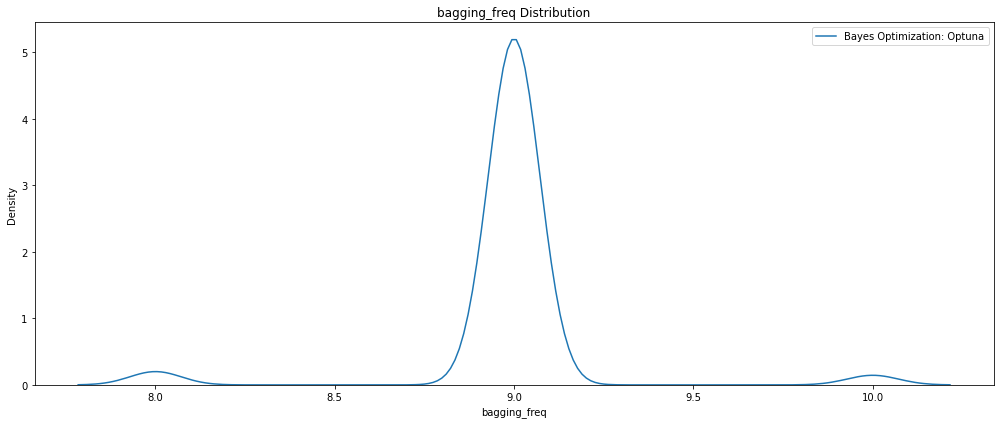

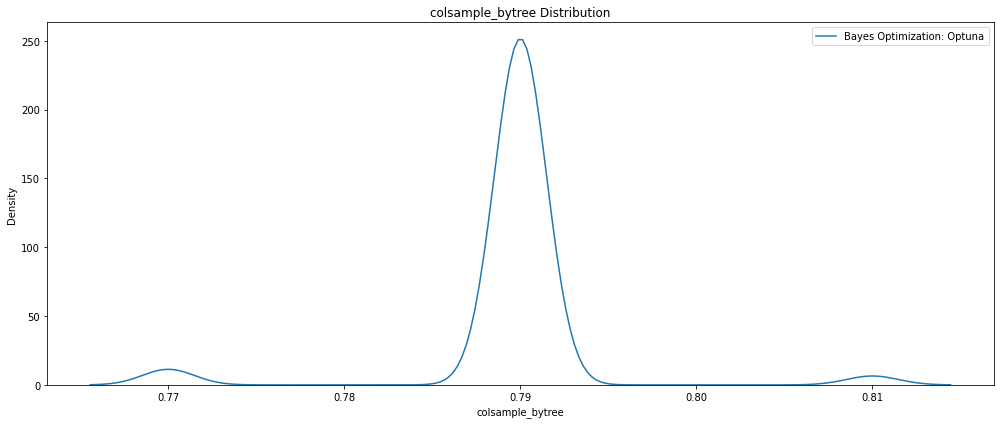

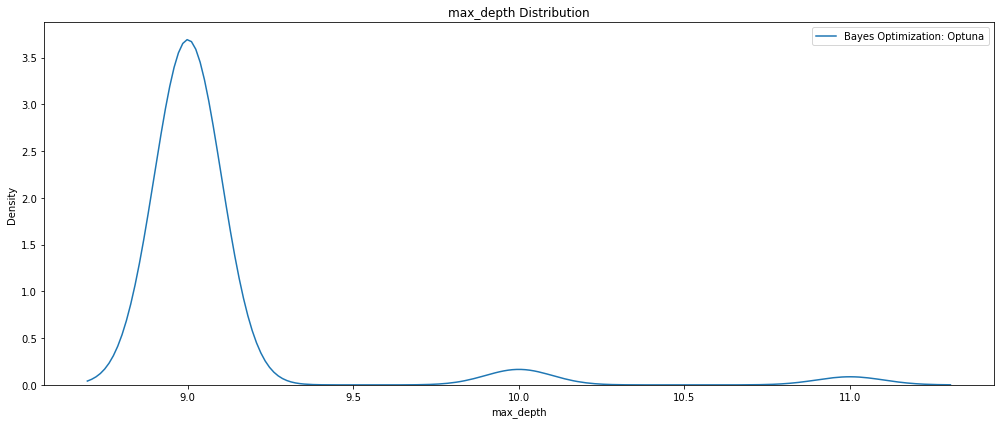

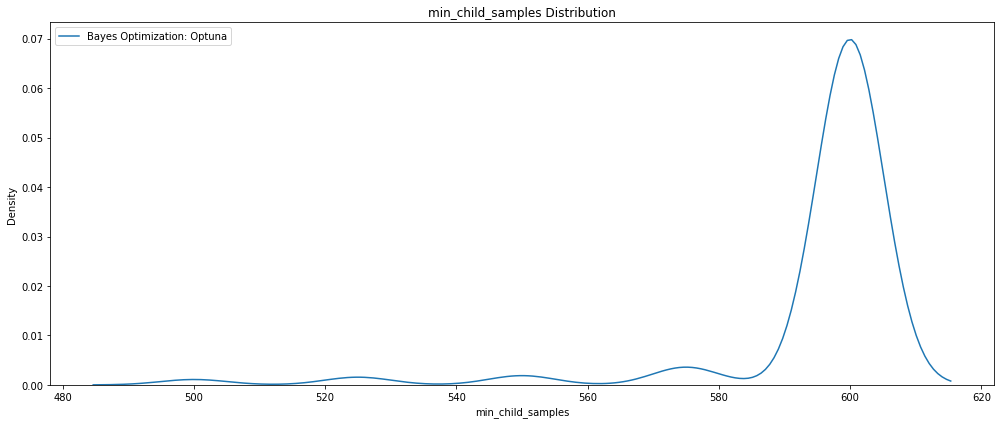

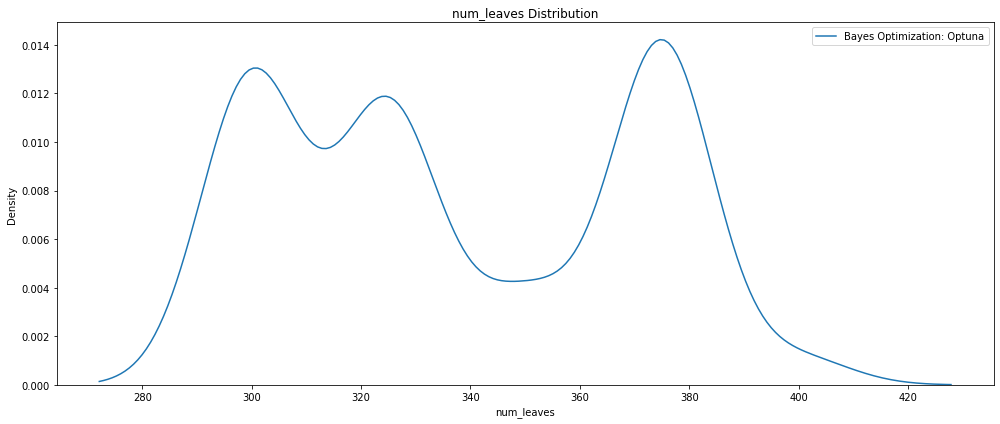

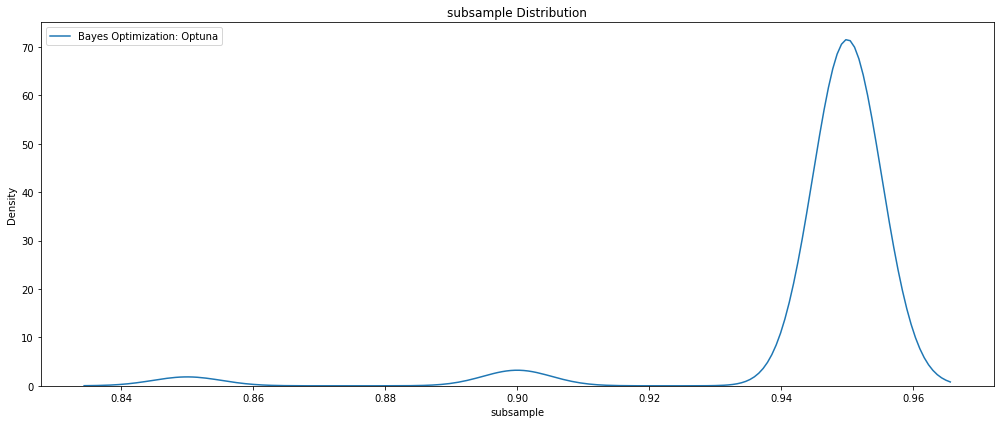

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

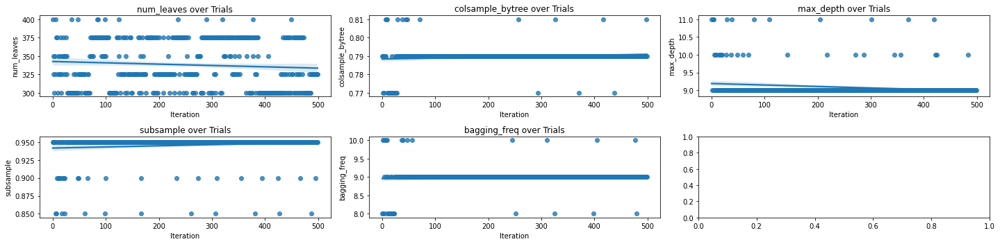

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_GPU_setParams_A4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_GPU_setParams_A4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 750,
 'num_leaves': 325,
 'bagging_freq': 9,
 'subsample': 0.95,
 'colsample_bytree': 0.79,
 'max_depth': 9,
 'min_child_samples': 600,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials_GPU_setParams_A4000_wb_trainTest_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials_GPU_setParams_A4000_wb_trainTest_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for lightGBM HPO GPU Set Parameters trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for lightGBM HPO GPU Set Parameters trials
MAE train: 1755.099, test: 1820.157
MSE train: 5602047.065, test: 6040379.591
RMSE train: 2366.864, test: 2457.718
R^2 train: 0.939, test: 0.934


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6040379.59068 MSE on the test set.
This was achieved using these conditions:
iteration                                   487
rmse                                2548.506773
datetime_start       2023-01-28 10:13:14.713609
datetime_complete    2023-01-28 10:13:28.025489
duration                 0 days 00:00:13.311880
bagging_freq                                  9
colsample_bytree                           0.79
max_depth                                     9
min_child_samples                           600
n_estimators                                750
num_leaves                                  325
subsample                                  0.95
state                                  COMPLETE
Name: 487, dtype: object


# Quadro P5000

In [ ]:
# Install/import dependencies
import os
import random
import numpy as np  
import warnings
import pandas as pd
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
optuna.logging.set_verbosity(optuna.logging.WARNING) 
from datetime import datetime, timedelta
from timeit import default_timer as timer
import pickle
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
warnings.filterwarnings('ignore')
my_dpi = 96
print('\n')
!nvcc --version
!nvidia-smi
os.environ['CUDA_VISIBLE_DEVICES'] = '0'



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Fri Feb  3 17:16:36 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro P5000        Off  | 00000000:00:05.0 Off |                  Off |
| 26%   41C    P8     9W / 180W |      2MiB / 16384MiB |      0%      Default |
|                               |    

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_setParams', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_setParams_P5000_trainTest_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_setParams_P5000_wb_trainTest_cuml.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 500, 1000, 
                                                step=250),
              'num_leaves': trial.suggest_int('num_leaves', 300, 400, step=25),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10, step=1),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95, 
                                               step=0.05),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81, step=0.02),
              'max_depth': trial.suggest_int('max_depth', 9, 11, step=1),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     500, 600, step=25),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Define model
    model = LGBMRegressor(**params)
    
    # Start timer for each trial
    start = timer()
      
     # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)])
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_setParams_P5000_wb_trainTest_cuml.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_setParams_P5000_wb_trainTest_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=500, callbacks=[wandbc])
# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-28 21:54:07.846455


Trial RMSE: 2464.1744605268327


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.4885971283397


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2451.126719259801


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2453.075087671981


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2460.653043781108


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.77


Trial RMSE: 2470.845717428723


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2436.145110216033


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2452.21801734095


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.77


Trial RMSE: 2417.712717434445


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.81


Trial RMSE: 2459.5258673976514


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2416.7433754407857


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2415.933618109709


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2414.1756792023875


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2411.2167155783904


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2420.392580550857


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2410.482338339471


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2421.800171781413


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2417.6806423386006


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2421.7784578969004


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2423.805617822969


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2435.7874548401746


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2412.943657697921


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2413.192052001336


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2416.3028289741096


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2412.4648751812206


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2415.879759333102


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2413.119889897245


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2446.9294859823094


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2411.183595758026


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2457.467633462101


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2411.6948472285253


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.46237438168


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2413.5852463220044


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2414.5812333174777


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2414.116490283425


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2425.5090584207724


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2476.948539670411


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2412.6620186429336


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2442.059401309386


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2416.6127203858564


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.81


Trial RMSE: 2428.632844488267


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2410.048903411474


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.1887516101565


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.0081408696465


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.7732554428294


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.6211976480868


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2448.2112054332156


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2408.875023804589


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.0924697686937


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.0195938685188


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.4595785037905


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.4649106325774


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.554657012274


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.2394971674053


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.1125358795107


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.6547188206737


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7925063283706


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.2487426301795


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2421.570702929973


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2425.0698755176963


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.9581441854243


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.428087078514


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.905846953367


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.6187964348346


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7740920906267


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.1764591797532


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.1786095389534


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.923321916276


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.0116094804844


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7108505034967


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2441.072417451712


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2409.5210234589877


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.6311820217475


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.9185882345905


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.8714489360173


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.823903798603


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.3572633140193


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.121210230236


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.9610138319636


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.450734315525


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2440.5934505751775


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2410.0497285373785


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.37057982655


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.934100192902


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.1286198163843


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.9851905564205


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.8024421161363


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.033273765423


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2413.951084254216


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.794932277512


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2414.6592322575625


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.391268725001


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.206595487877


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.344674180394


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2448.3049751075337


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.8475456004403


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.6489806195204


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.0765009111683


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.1091928494966


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.1963953953764


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.7819908358406


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.9405366869564


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.4449489614676


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7968522000765


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2417.3089655556755


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.4165834918413


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.970361930796


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.6314712507174


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.9436543620895


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.17585964014


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.6830164821163


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.0648376357112


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.6416262966204


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.846126956475


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.0566434642337


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.1914123652687


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.928274102244


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.4715962284176


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.7853376235716


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.8026369335325


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.687761105761


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.235078686924


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.9215261753984


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.7139657462526


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.2390340278794


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.1567143535485


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.1824342190107


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.076275974448


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2416.9953513922965


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.8442967630754


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2419.3638816205053


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.6557066165246


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.5515048449442


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.4315746738184


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.9734793465013


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.8436091311123


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2432.9050064150933


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.203702333759


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2424.391145240556


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.821240265868


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2446.8585574719996


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.2178965021612


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.7378947648513


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.6982573026075


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.5935032749967


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.8522030051354


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.693554925763


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.5434781265494


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.3790085261476


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.648790903126


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.529245752216


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.2215539531244


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.110652841955


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.912884231396


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.045733468148


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.3051693192724


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.135095632161


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.410766518765


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.381831412116


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.6669516336474


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.36995278825


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.2006149331824


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.178573530602


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.648746170649


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.970925007014


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.9350345376433


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.0820906241956


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.7922431092297


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.803067547845


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.8924055770353


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.5338599834613


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.2425336541655


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.1254948756696


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.29115022157


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.5346529167255


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.9773409158297


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2419.3602410564927


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.5770893930626


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.9332945886354


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.355745101333


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.461123113184


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.9165710455436


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.8200978625073


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.122209575384


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.64303354189


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.0076302012285


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.644051857438


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.2563125471233


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.422879425213


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.094178005372


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.035202162385


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.279354174408


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.1751496997726


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.642161456567


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.0906029571756


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2418.806475376293


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2424.3109152425322


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.54300224788


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2414.485798898653


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.863806988359


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.1812639905397


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.052748486959


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.296137692515


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.105912235088


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.995281811852


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.7294076013736


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.217809509555


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.9838937520394


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.3296829955043


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.6665001256883


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.8019624921435


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.4785784931746


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.983507006369


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.7354358356424


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.781312828013


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.9884529154638


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.726029302075


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.6523802997453


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.40315345456


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.844443650033


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.919068128238


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.836762504412


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.165620560762


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.1408604775875


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.052716439435


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.913449809606


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.5383404270415


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.109603747463


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.0476693069077


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2419.035454758588


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2410.868097441304


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.041611637121


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.7772141930327


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.3432096205306


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.8571634406158


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.867445170556


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.0033754004107


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.423432727113


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.6016025142126


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2431.70022289426


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.878558932756


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.051484623942


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2447.3228631949523


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2413.3051190719207


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2411.7483671133596


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2414.225392406378


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.8636789982424


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.2308763005412


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.9026545513657


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.9196882178358


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.991336153273


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.6891111264213


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.4958931611513


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.812506244508


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.7940130359298


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.793216800786


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.6621973475458


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2423.9018456104604


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.644711098584


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.786938132048


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.899500938432


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.050912741871


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2415.988041839716


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.1905860832126


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.354939026623


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.03404449022


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.3277935791875


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.0968694730027


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.3211388142668


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.3415631809717


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.9673168976533


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.519701612708


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.8797097898155


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.1494836135503


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2416.7209814693533


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.127358746212


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7915692674433


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.6091227858815


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.600205681406


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.275679460328


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.0622646692286


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.3196632314607


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.4141782605952


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.2510973485973


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.9007739305857


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.929732592597


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2413.3924874724553


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.1324346977335


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2420.306993133582


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.2430255123527


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.69936610811


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.6905435937115


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.4117071190162


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2417.451772431613


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.8129404732176


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2414.4456458718437


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.4600788289695


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.8777349304546


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.537651726548


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2431.718924211883


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2425.457991105469


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.1243212671475


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.9294523290787


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.5356487484105


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.925666664536


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.2962678576678


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2459.439451019369


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.9948338834283


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.2325341125706


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.436654203897


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.060756535741


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.967683658241


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.033873507919


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7644232454923


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.0631506984355


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.6552455900937


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.6702266657494


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.189964549746


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.0807265126277


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2416.712052718264


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2411.3726960813033


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.455228484621


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.644691696756


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.609009892462


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2408.9824434854545


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2410.2151529227763


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.9820750377435


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.2141878190314


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.9178565812826


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2420.7357484526083


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.0839214978046


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.799219408132


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.3075404896717


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.221078774469


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.4053748306806


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.7257109219313


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.0105319629897


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.2039393991254


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.5122708806057


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.880086592377


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.559268247166


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.146019815987


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.494848275264


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.50539508366


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2423.652101993073


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.293909296991


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.54089312629


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.945872347965


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.9214977325155


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.900964426685


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2413.8293190071463


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.314514309684


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7972893160018


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.050138312562


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.813229736289


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2418.9673156317526


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.5929568465535


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.739878055418


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2410.0863879347985


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.1721652075985


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2431.7478040632395


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.053686392731


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.043270269095


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.287671510423


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.5709832894318


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.387437462713


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.01561628112


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.287775659911


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.461833795676


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.7328785877075


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.3272134774174


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.86151171185


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.2591112229125


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.793943768524


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.809648229723


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.788495291369


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.6609092162203


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.9673427193643


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.364583237593


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2446.462039809756


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.9227340738453


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2427.8314460246042


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.2186979968824


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.212852503843


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.721327545024


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.1983976094825


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2417.210833803692


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.1331404671078


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.3106845350962


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.1870946286795


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.4068785005907


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.2487166516503


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.1817376416097


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.523417347732


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.4370857706203


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.1316154630103


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.1336875365814


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2409.146316601072


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.75299960011


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.836977609213


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.532107945429


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.1241661428626


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2413.4452973433636


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.834080912787


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.731297770508


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2418.0898422668624


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.0347393285465


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.3275178760146


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2417.609631989334


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.303031102467


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2415.481723356653


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,10
colsample_bytree,0.79


Trial RMSE: 2418.849908112084


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2432.8317901749992


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.5357784402936


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.9123233968594


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.204129053371


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.6041331898155


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.305330058138


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.132024888903


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.806682642452


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.770674588666


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2427.6181740508496


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.5503186017527


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7328773317977


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.626905212003


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.832874748841


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2414.193391817131


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.3012857721183


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2447.863629162013


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7940993973293


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.74245358359


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.72164634483


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.780322907281


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.7633089490223


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.284326902062


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.0967945506736


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.946202551433


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,8
colsample_bytree,0.79


Trial RMSE: 2411.9205237952365


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.8621694047774


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.4314295044624


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.365390482187


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2419.4239391352457


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.7928462723116


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.800957633261


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.311492641087


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7047713734537


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7997261080336


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.7919630879474


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.7068105148605


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.268137439304


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.5165026184554


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2424.913075499847


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.0507458022003


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.156827710141


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.5808979775284


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.426356635404


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2407.4677883561817


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2409.336735790712


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.0591887807764


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2410.7908661264855


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.678503669971


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2409.0712480107304


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2409.3452085529484


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2409.0668836424


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2411.5050048166536


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2409.7945800364323


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2409.4765462689656


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2410.398793764956


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2409.084163143968


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2409.160089005966


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.81


Trial RMSE: 2412.4368921470173


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.031523263703


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.3085598072207


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2409.851740444372


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2419.9580311340064


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.291069042992


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2417.066358955572


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2412.4312107752244


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.241740953229


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.821319189827


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.630649070625


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2410.6964723127344


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.127860686656


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.937870670457


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.585276037849


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.77


Trial RMSE: 2410.8939450761827


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.600300110332


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.3259431260494


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2447.3333461001785


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.732382634132


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.37185170637


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2431.941191021705


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2409.9967445158936


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2408.9514689604657


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


Trial RMSE: 2411.469399782155


bagging_freq,▁
colsample_bytree,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁
value,▁
bagging_freq,9
colsample_bytree,0.79


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_GPU_P5000_setParams_wb_trainTest_cuml.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
190        190  2407.035202 2023-01-28 23:54:26.137430   
166        166  2407.082091 2023-01-28 23:38:51.586861   
333        333  2407.221079 2023-01-29 01:29:21.139810   
233        233  2407.343210 2023-01-29 00:21:36.495972   
102        102  2407.444949 2023-01-28 22:57:12.456824   
..         ...          ...                        ...   
4            4  2460.653044 2023-01-28 21:56:25.629479   
0            0  2464.174461 2023-01-28 21:54:07.847899   
5            5  2470.845717 2023-01-28 21:57:05.083919   
36          36  2476.948540 2023-01-28 22:15:32.718364   
499        499          NaN 2023-01-29 03:26:54.072107   

             datetime_complete               duration  bagging_freq  \
190 2023-01-28 23:54:56.315182 0 days 00:00:30.177752           9.0   
166 2023-01-28 23:39:21.046801 0 days 00:00:29.459940           9.0   
333 2023-01-29 01:29:54.311346 0 days 00:00:33.171536           9.0   
233 2023-01-29 00:2

In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_GPU_P5000_setParams_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_GPU_P5000_setParams_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_GPU_P5000_setParams_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves',
                                                       'max_depth', 
                                                       'subsample',
                                                       'colsample_bytree'])
py.plot(fig, filename='contour_lightGBM_Optuna_GPU_P5000_setParams_wb_trainTest_cuml.html')
fig.show()

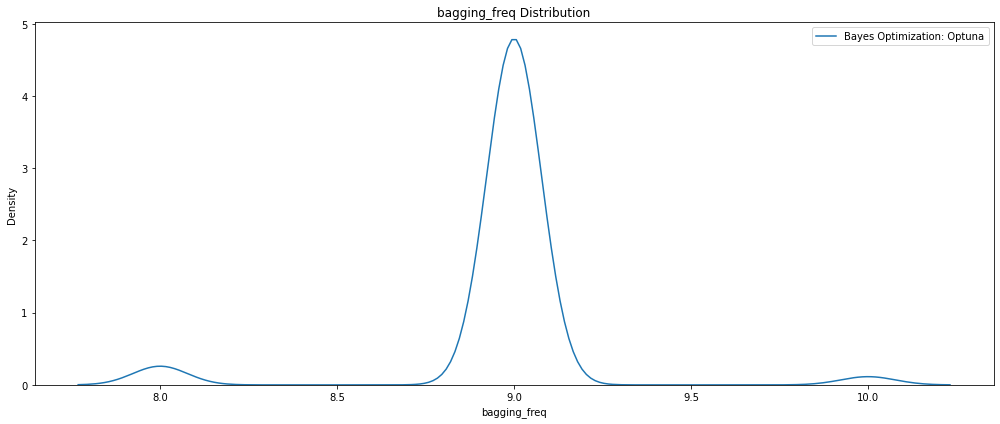

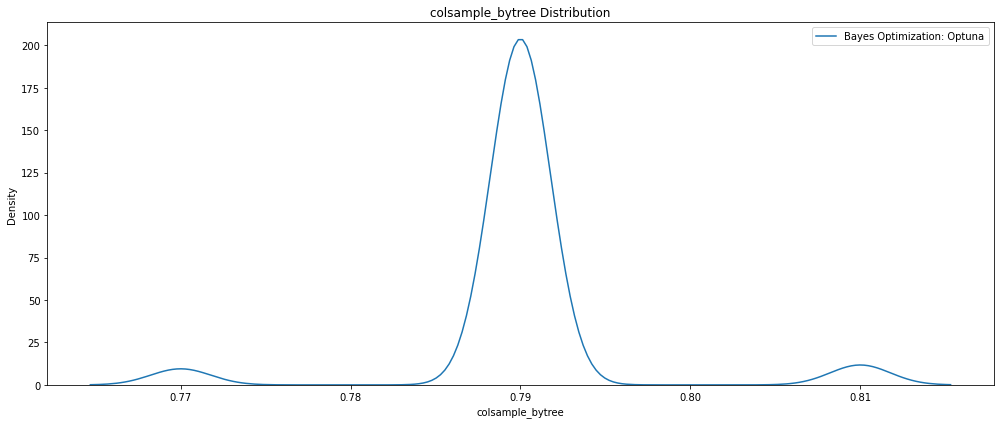

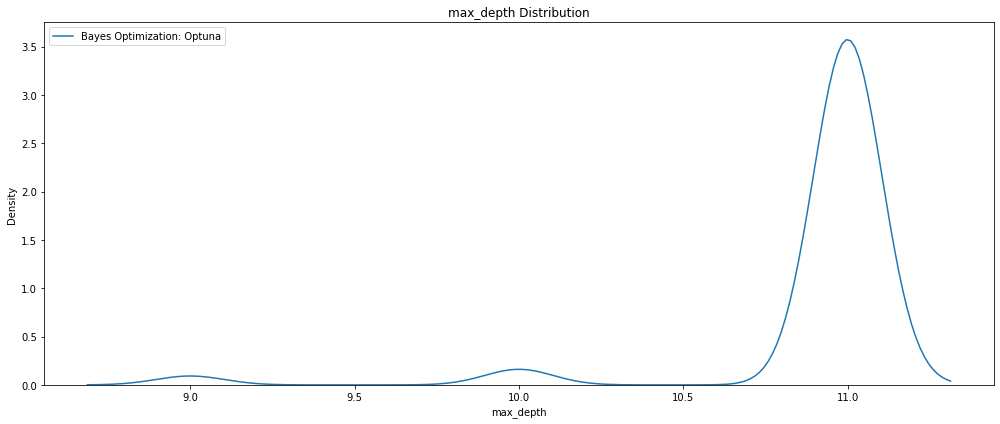

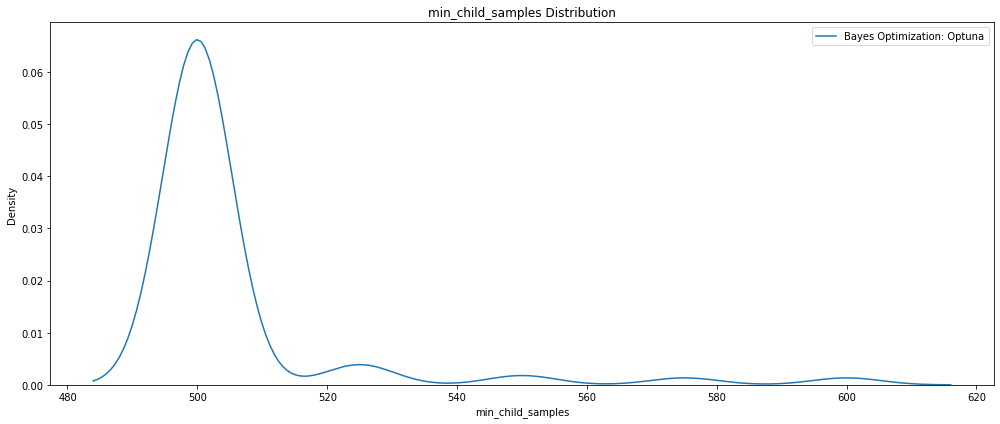

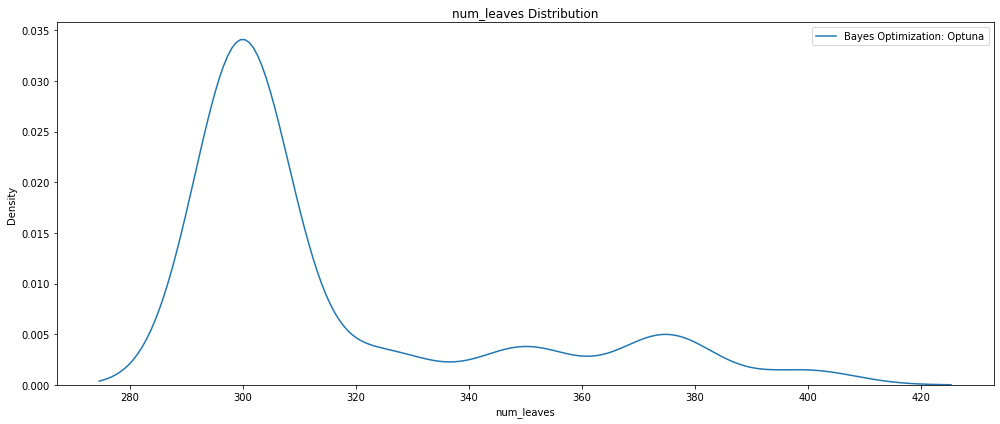

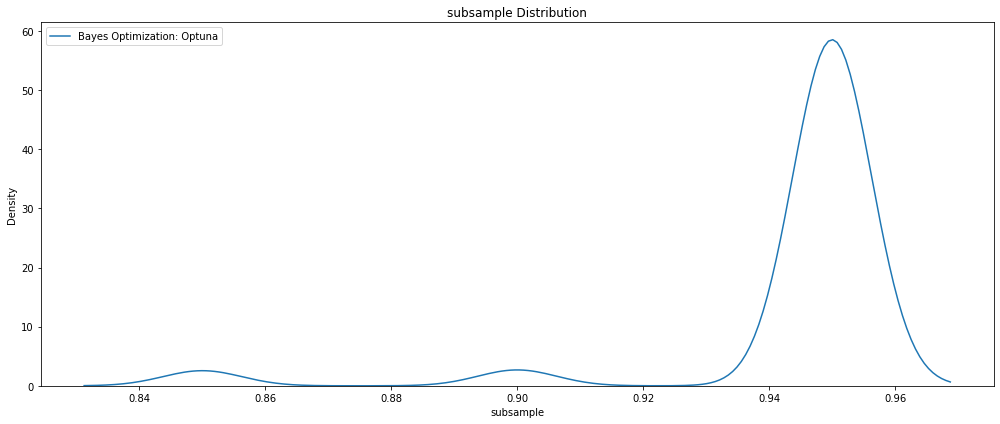

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

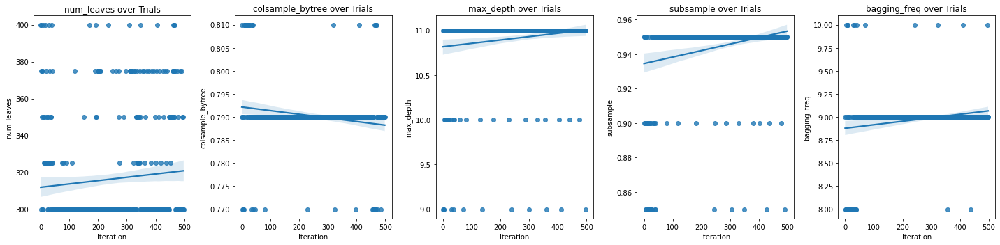

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 5, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_GPU_P5000_setParams_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_GPU_P5000_setParams_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 1000,
 'num_leaves': 375,
 'bagging_freq': 9,
 'subsample': 0.95,
 'colsample_bytree': 0.79,
 'max_depth': 11,
 'min_child_samples': 500,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials_GPU_setParams_P5000_wb_trainTest_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials_GPU_setParams_P5000_wb_trainTest_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1642.710, test: 1776.493
MSE train: 4940131.145, test: 5806179.719
RMSE train: 2222.641, test: 2409.602
R^2 train: 0.946, test: 0.936


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5806179.71895 MSE on the test set.
This was achieved using these conditions:
iteration                                   190
rmse                                2407.035202
datetime_start       2023-01-28 23:54:26.137430
datetime_complete    2023-01-28 23:54:56.315182
duration                 0 days 00:00:30.177752
bagging_freq                                9.0
colsample_bytree                           0.79
max_depth                                  11.0
min_child_samples                         500.0
n_estimators                             1000.0
num_leaves                                375.0
subsample                                  0.95
state                                  COMPLETE
Name: 190, dtype: object
